In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
import itertools
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN

## Data Preparation

In [2]:
# load data
df = pd.read_csv('AEP_hourly.csv')
df

,Datetime,AEP_MW
0,2004-12-31 01:00:00,13478.0
1,2004-12-31 02:00:00,12865.0
2,2004-12-31 03:00:00,12577.0
3,2004-12-31 04:00:00,12517.0
4,2004-12-31 05:00:00,12670.0
...,...,...
121268,2018-01-01 20:00:00,21089.0
121269,2018-01-01 21:00:00,20999.0
121270,2018-01-01 22:00:00,20820.0
121271,2018-01-01 23:00:00,20415.0


## Feature Engineering 

In [3]:
df['Datetime'] = pd.to_datetime(df['Datetime'])
df['Date']=df['Datetime'].dt.date
df['Hour']=df['Datetime'].dt.hour
df = df.drop(['Datetime'], axis=1)
df = df.pivot_table(index='Date', columns='Hour', values='AEP_MW')
df = df.reindex(columns=range(24), fill_value=None)
df = df.interpolate(method='linear')
df.bfill(inplace=True)
df.head()

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Date,,,,,,,,,,,,,,,,,,,,,
2004-10-01,13147.0,12379.0,11935.0,11692.0,11597.0,11681.0,12280.0,13692.0,14618.0,14903.0,...,15655.0,15739.0,15739.0,15644.0,15353.0,15034.0,15211.0,15349.0,14837.0,14067.0
2004-10-02,13147.0,12260.0,11672.0,11352.0,11177.0,11142.0,11331.0,11866.0,12387.0,13144.0,...,13934.0,13758.0,13579.0,13620.0,13483.0,13379.0,13825.0,14056.0,14015.0,12940.0
2004-10-03,12172.0,11443.0,10807.0,10600.0,10438.0,10430.0,10509.0,10795.0,11288.0,11965.0,...,12924.0,12759.0,12605.0,12755.0,12795.0,12979.0,13819.0,14237.0,13878.0,13132.0
2004-10-04,12351.0,11817.0,11408.0,11261.0,11247.0,11414.0,12283.0,13862.0,14864.0,15046.0,...,15803.0,15747.0,15689.0,15617.0,15441.0,15368.0,15910.0,16133.0,15583.0,14497.0
2004-10-05,13405.0,12532.0,12126.0,11926.0,11914.0,12010.0,12770.0,14393.0,15444.0,15547.0,...,15450.0,15259.0,15107.0,15101.0,14984.0,14976.0,15649.0,16007.0,15469.0,14520.0


In [4]:
df.isnull().sum().sum()

0

## Data Normalization

In [5]:
scaler = StandardScaler()
train = scaler.fit_transform(df)
train = pd.DataFrame(train, columns=df.columns)
train.head()

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,-0.782680,-0.797082,-0.780240,-0.762671,-0.746342,-0.749900,-0.689599,-0.439453,-0.334694,-0.391576,...,-0.377949,-0.309673,-0.282036,-0.355247,-0.561348,-0.739412,-0.695221,-0.660967,-0.779600,-0.780899
1,-0.782680,-0.859800,-0.917261,-0.936397,-0.955596,-1.009111,-1.119522,-1.176012,-1.202346,-1.140693,...,-1.117244,-1.123053,-1.144949,-1.155491,-1.305675,-1.406302,-1.293529,-1.264984,-1.172249,-1.343008
2,-1.289869,-1.290396,-1.367920,-1.320638,-1.323785,-1.351519,-1.491911,-1.608024,-1.629755,-1.642802,...,-1.551113,-1.533233,-1.534059,-1.497493,-1.579524,-1.567484,-1.296119,-1.180431,-1.237690,-1.247245
3,-1.196754,-1.093281,-1.054804,-0.982894,-0.920721,-0.878303,-0.688240,-0.370880,-0.239023,-0.330675,...,-0.314372,-0.306389,-0.302010,-0.365922,-0.526321,-0.604825,-0.393477,-0.294727,-0.423255,-0.566429
4,-0.648470,-0.716444,-0.680731,-0.643106,-0.588405,-0.591681,-0.467615,-0.156689,-0.013457,-0.117311,...,-0.466011,-0.506757,-0.534518,-0.569937,-0.708223,-0.762783,-0.506146,-0.353587,-0.477710,-0.554957


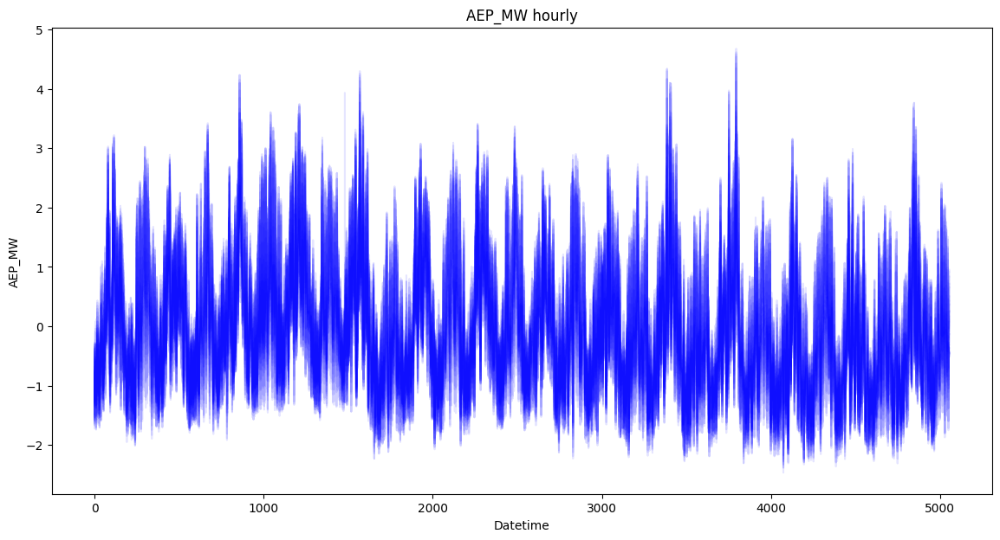

In [6]:
plt.figure(figsize=(14, 7))
train.plot(legend=False, ax=plt.gca(), alpha=0.1, color='blue')
plt.xlabel('Datetime')
plt.ylabel('AEP_MW')
plt.title('AEP_MW hourly')
plt.show()


## Clustering 

In [7]:
def evaluate_kmeans(data, max_clusters=5):
    silhouette_scores = []
    for k in range(2, max_clusters + 1): 
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        labels = kmeans.labels_
        score = silhouette_score(data, labels)
        silhouette_scores.append((k, score))
        print(f'K: {k}, Silhouette Score: {score}')
    return silhouette_scores


In [8]:
silhouette_scores = evaluate_kmeans(train, max_clusters=10)

K: 2, Silhouette Score: 0.446445023798786
K: 3, Silhouette Score: 0.34765289283386863
K: 4, Silhouette Score: 0.3688806407500338
K: 5, Silhouette Score: 0.33997316764594604
K: 6, Silhouette Score: 0.34211081290625883
K: 7, Silhouette Score: 0.3188370480274405
K: 8, Silhouette Score: 0.309912805699209
K: 9, Silhouette Score: 0.29798173166486
K: 10, Silhouette Score: 0.2925717400325125


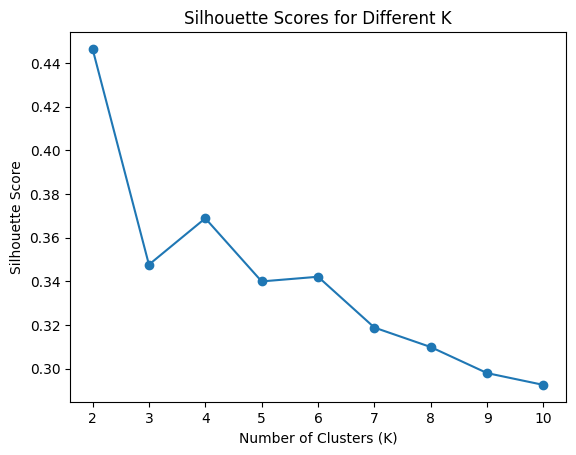

In [9]:
# Plot the silhouette scores 
k_values, scores = zip(*silhouette_scores)
plt.plot(k_values, scores, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Scores for Different K')
plt.show()

In [10]:
optimal_k = 2

### K-Means Clustering

In [11]:
kmeans = KMeans(n_clusters=optimal_k, random_state=42,)
kmeans.fit_predict(train)
labels = kmeans.labels_

### Agglomerative Clustering

In [12]:
agg = AgglomerativeClustering(n_clusters=optimal_k)
agg_labels = agg.fit_predict(train)

### DBSCAN Clustering

In [13]:
dbscan = DBSCAN(eps=1, min_samples=20, metric='euclidean')
dbscan_labels = dbscan.fit_predict(train)

## Visualization

In [14]:
def plot_pca_component_pairs(pca_result, labels, cluster_centers=None, n_components=10, fig_size=(35, 45), rows=9, cols=5, title='PCA Component Pairs'):
    # pairs of component combinations
    component_pairs = list(itertools.combinations(range(n_components), 2))

    fig, axes = plt.subplots(rows, cols, figsize=fig_size,) 
    axes = axes.flatten() 
    for idx, (i, j) in enumerate(component_pairs):
        ax = axes[idx]
        
        # Plot each cluster with a unique color
        for cluster_label in np.unique(labels):  
            if cluster_label == -1:
                color = 'red'  # Noise points in DBSCAN
                label_name = 'Noise'
            else:
                color = None  # Automatically assign colors
                label_name = f'Cluster {cluster_label+1}'

            ax.scatter(pca_result[labels == cluster_label, i], pca_result[labels == cluster_label, j], 
                       s=20, label=label_name, c=color, alpha=0.8, edgecolors='k')
            ax.legend()        
        if cluster_centers is not None:
            ax.scatter(cluster_centers[:, i], cluster_centers[:, j], 
                       s=100, c='yellow', label='Centroids', marker='x')
        
        ax.set_title(f'PC {i+1} vs PC {j+1}')
        ax.set_xlabel(f'PC {i+1}')
        ax.set_ylabel(f'PC {j+1}')

    for ax in axes[len(component_pairs):]:
        ax.axis('off')
    
    

    fig.suptitle(title, fontsize=20)
    plt.tight_layout()
    plt.show()

In [21]:
"""
Note Take 10 components for make difference viualization as the data has 24 features take only 2 components and visualize may not show good separation
so take 10 components and make difference visualization with each pair of components to see the difference prespective for data clustering
"""
pca = PCA(n_components=10) 
pca_result = pca.fit_transform(train)

### 2D Visualization from different perspectives 

#### K-Means Clustering

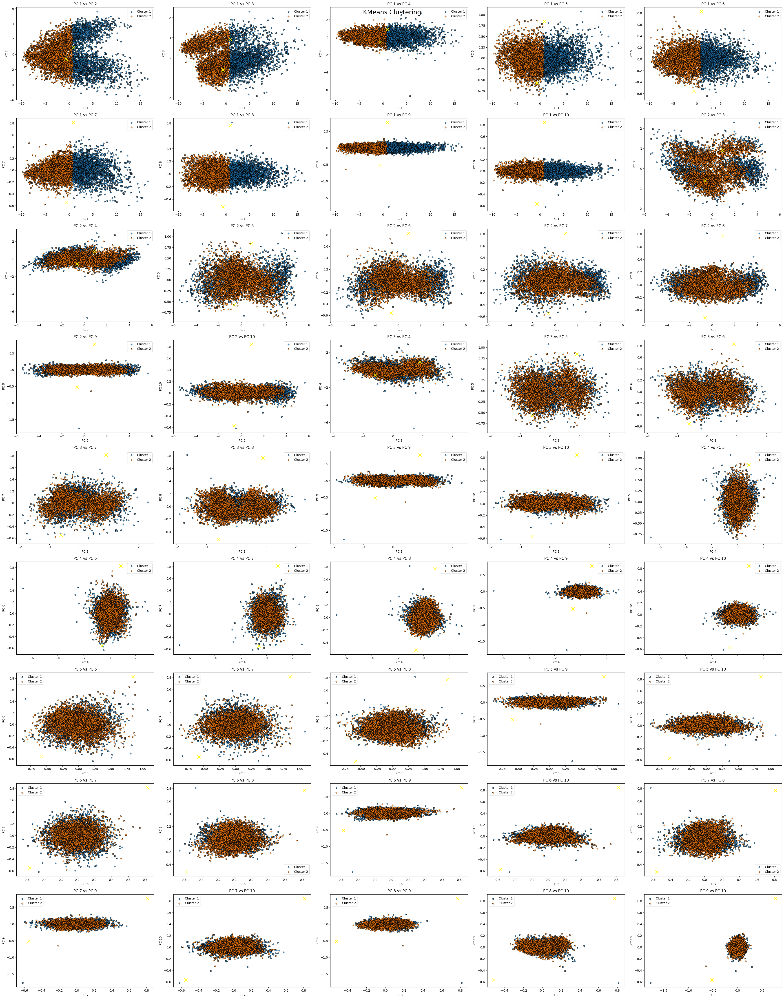

In [16]:
plot_pca_component_pairs(pca_result, labels, kmeans.cluster_centers_, title='KMeans Clustering')

#### DBSCAN Clustering

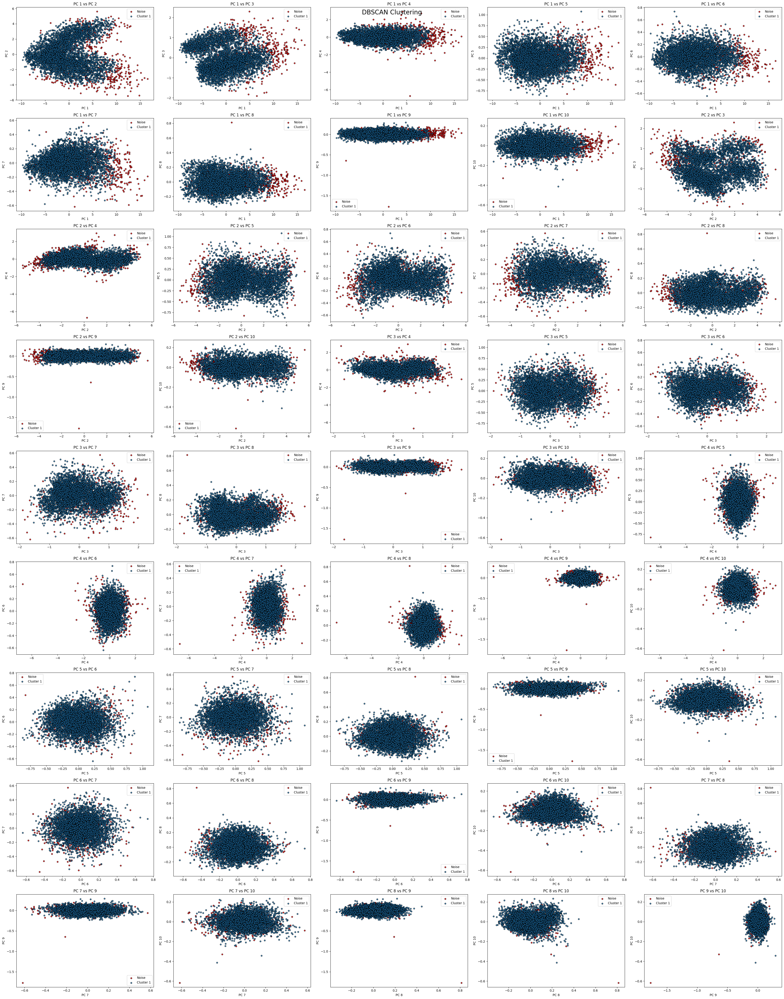

In [17]:
plot_pca_component_pairs(pca_result=pca_result, labels=dbscan_labels, cluster_centers=None, title='DBSCAN Clustering')

#### Agglomerative Clustering

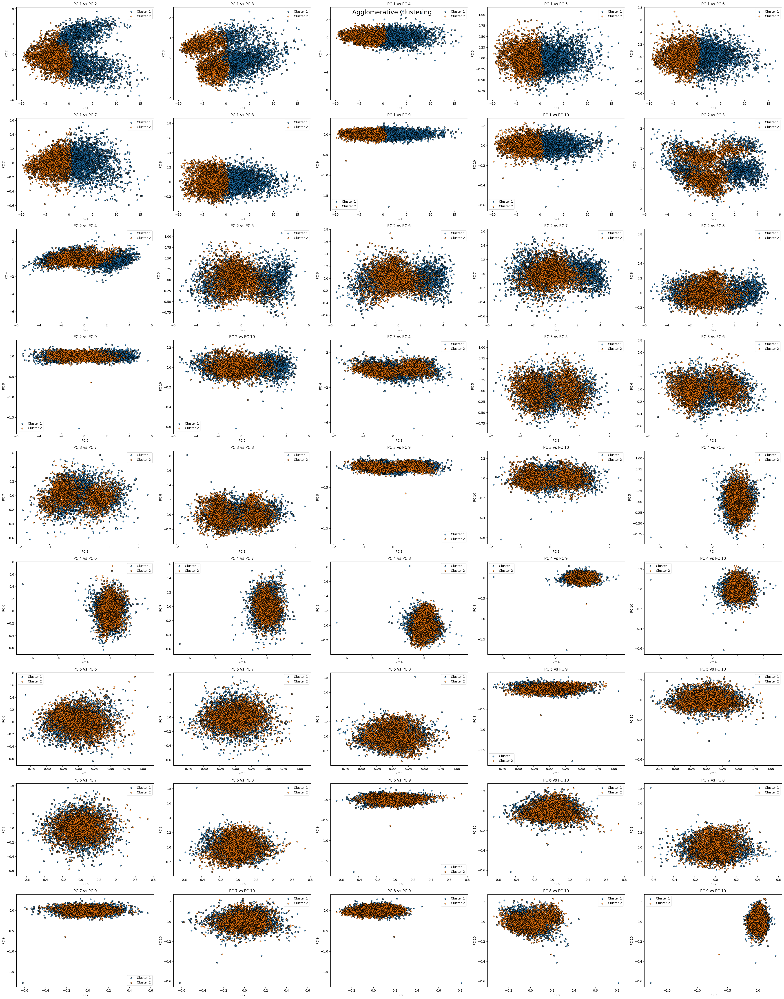

In [18]:
plot_pca_component_pairs(pca_result=pca_result, labels=agg_labels, cluster_centers=None, title='Agglomerative Clustering')

## Conclusions

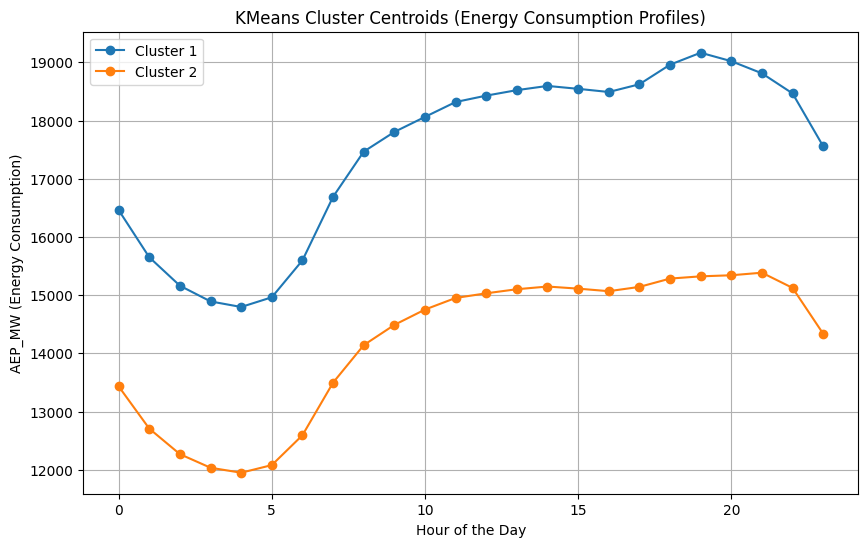

In [19]:
centroids = kmeans.cluster_centers_
centroids_original_scale = scaler.inverse_transform(centroids)
plt.figure(figsize=(10, 6))
for i, centroid in enumerate(centroids_original_scale):
    plt.plot(range(24), centroid, label=f'Cluster {i+1}', marker='o')
    
plt.xlabel('Hour of the Day')
plt.ylabel('AEP_MW (Energy Consumption)')
plt.title('KMeans Cluster Centroids (Energy Consumption Profiles)')
plt.legend()
plt.grid(True)
plt.show()

### Interpretation:

#### Cluster 1 (Blue Line):

- This cluster represents a group of days where the energy consumption is generally **higher throughout the day** compared to Cluster 2.
- The consumption starts at around **16,500 MW at midnight (0 hour)**, dips to around **16,000 MW** in the early morning hours (around **4–6 AM**), and then rises steadily throughout the day, peaking at around **19,000 MW** in the late afternoon/evening (around **5–6 PM**).
- After the peak, the consumption gradually decreases again towards the night.
- This could represent days with **higher energy demand**, possibly **weekdays** or days where the energy usage follows a consistent workday pattern, with increased demand in the afternoon and evening.

#### Cluster 2 (Orange Line):

- This cluster represents a group of days with **lower overall energy consumption** compared to Cluster 1.
- The consumption starts at around **13,000 MW at midnight**, dips to around **12,000 MW** in the early morning hours (around **4–6 AM**), and then rises, but not as significantly as in Cluster 1.
- The peak consumption in this cluster is around **15,000 MW** in the afternoon, and the energy consumption remains relatively stable throughout the day.
- This could represent days with **lower energy demand**, possibly **weekends, holidays**, or days with less overall activity compared to the days in Cluster 1.

### Insights:

- **Cluster 1** might represent **high-demand days** **(likely weekdays)**, where energy consumption follows a typical workday pattern: lower during the night, increasing steadily in the afternoon, and reaching a peak in the early evening.
- **Cluster 2** might represent **low-demand days** **(likely weekends or holidays)**, where energy consumption is lower throughout the day and doesn’t fluctuate as much as in Cluster 1.

This plot helps distinguish two distinct patterns of energy consumption over a 24-hour period, which could be useful for understanding daily operational demands and **optimizing energy production or distribution** accordingly.


In [20]:
kmeans_cluster_counts = pd.Series(labels).value_counts()
dbscan_cluster_counts = pd.Series(dbscan_labels).value_counts()
agg_cluster_counts = pd.Series(agg_labels).value_counts()

print("KMeans Cluster Sizes:")
print(kmeans_cluster_counts)

print("\nDBSCAN Cluster Sizes (including noise):")
print(dbscan_cluster_counts)

print("\nAgglomerative Clustering Sizes:")
print(agg_cluster_counts)


KMeans Cluster Sizes:
1    3014
0    2041
Name: count, dtype: int64

DBSCAN Cluster Sizes (including noise):
 0    4625
-1     430
Name: count, dtype: int64

Agglomerative Clustering Sizes:
0    2638
1    2417
Name: count, dtype: int64
